In [1]:

## Setup and Configuration
import torch
import torch.optim as optim
import torch.nn as nn
from torchvision import datasets, transforms
from torch.utils.data import DataLoader
from torchvision.utils import save_image
import os
from pathlib import Path
import matplotlib.pyplot as plt
%matplotlib inline
from collections import defaultdict
import glob

# Configuration

In [ ]:
# Configuration
class Config:
    version = "1.0"
    git_hash = os.getenv("GIT_HASH", "dev")

    device = "cuda" if torch.cuda.is_available() else "cpu"
    latent_dim = 100
    batch_size = 64
    epochs = 15
    lr_G = 0.0002
    lr_D = 0.0002
    gp_weight = 10
    n_critic = 5
    sample_interval = 5
    checkpoint_interval = 5
    sample_dir = "samples"
    dataset = "cifar10"
    resume=False
    base_dir = Path("outputs")
    dirs = {
        'models': base_dir/"models",
        'samples': base_dir/"samples",
        'checkpoints': base_dir/"checkpoints", 
        'metrics': base_dir/"metrics",
        'results': base_dir/"results",
    }
    
    
    def __init__(self):
        # Create all directories
        for dir_path in self.dirs.values():
            os.makedirs(dir_path, exist_ok=True)
            
        # Create data directory if not exists
        os.makedirs("data", exist_ok=True)

config = Config()

# Generator Architecture

In [ ]:
class Generator(nn.Module):
    def __init__(self, latent_dim):
        super().__init__()
        self.main = nn.Sequential(
            # Input: latent_dim x 1 x 1
            nn.ConvTranspose2d(latent_dim, 512, 4, 1, 0, bias=False),
            nn.BatchNorm2d(512),
            nn.ReLU(True),
            
            nn.ConvTranspose2d(512, 256, 4, 2, 1, bias=False),
            nn.BatchNorm2d(256),
            nn.ReLU(True),
            
            nn.ConvTranspose2d(256, 128, 4, 2, 1, bias=False),
            nn.BatchNorm2d(128),
            nn.ReLU(True),
            
            nn.ConvTranspose2d(128, 64, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(True),
            
            nn.ConvTranspose2d(64, 3, 4, 2, 1, bias=False),
            nn.Tanh()
        )
    def forward(self, x):
        return self.main(x)


# Discriminator Architecture

In [43]:

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.main = nn.Sequential(
            # Input: 3x64x64
            nn.Conv2d(3, 64, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            
            nn.Conv2d(64, 128, 4, 2, 1, bias=False),
            nn.InstanceNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True),
            
            nn.Conv2d(128, 256, 4, 2, 1, bias=False),
            nn.InstanceNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),
            
            nn.Conv2d(256, 512, 4, 2, 1, bias=False),
            nn.InstanceNorm2d(512),
            nn.LeakyReLU(0.2, inplace=True),
            
            nn.Conv2d(512, 1, 4, 1, 0, bias=False)
        )

    def forward(self, x):
        return self.main(x).view(-1)


# PyTorch Lookahead Implementation

In [45]:
class Lookahead(torch.optim.Optimizer):
    """
    PyTorch implementation of the lookahead wrapper.
    Lookahead Optimizer: https://arxiv.org/abs/1907.08610
    """
    def __init__(self, optimizer, k=5, alpha=0.5):
        self.optimizer = optimizer
        self.k = k
        self.alpha = alpha
        self.param_groups = self.optimizer.param_groups
        self.state = defaultdict(dict)
        self.fast_state = self.optimizer.state
        for group in self.param_groups:
            group["counter"] = 0
    
    def update(self, group):
        for fast in group["params"]:
            param_state = self.state[fast]
            if "slow_param" not in param_state:
                param_state["slow_param"] = torch.zeros_like(fast.data)
                param_state["slow_param"].copy_(fast.data)
            slow = param_state["slow_param"]
            slow += (fast.data - slow) * self.alpha
            fast.data.copy_(slow)
    
    def step(self, closure=None):
        loss = self.optimizer.step(closure)
        for group in self.param_groups:
            group["counter"] += 1
            if group["counter"] >= self.k:
                group["counter"] = 0
                self.update(group)
        return loss
    
    def state_dict(self):
        fast_state_dict = self.optimizer.state_dict()
        slow_state = {
            (id(k) if isinstance(k, torch.Tensor) else k): v
            for k, v in self.state.items()
        }
        fast_state = fast_state_dict["state"]
        param_groups = fast_state_dict["param_groups"]
        return {
            "fast_state": fast_state,
            "slow_state": slow_state,
            "param_groups": param_groups,
        }
    
    def load_state_dict(self, state_dict):
        slow_state_dict = {
            "state": state_dict["slow_state"],
            "param_groups": state_dict["param_groups"],
        }
        fast_state_dict = {
            "state": state_dict["fast_state"],
            "param_groups": state_dict["param_groups"],
        }
        super(Lookahead, self).load_state_dict(slow_state_dict)
        self.optimizer.load_state_dict(fast_state_dict)
        self.fast_state = self.optimizer.state

    def add_param_group(self, param_group):
        param_group["counter"] = 0
        self.optimizer.add_param_group(param_group)

# Utils functions

In [4]:
def ensure_dir(path):
    """Ensure directory exists"""
    os.makedirs(path, exist_ok=True)

def gradient_penalty(D, real, fake, device):
    """Compute gradient penalty for WGAN-GP"""
    alpha = torch.rand(real.size(0), 1, 1, 1).to(device)
    interpolates = (alpha * real + ((1 - alpha) * fake)).requires_grad_(True)
    d_interpolates = D(interpolates)
    
    gradients = torch.autograd.grad(
        outputs=d_interpolates,
        inputs=interpolates,
        grad_outputs=torch.ones(d_interpolates.size()).to(device),
        create_graph=True,
        retain_graph=True,
        only_inputs=True
    )[0]
    
    gradients = gradients.view(gradients.size(0), -1)
    penalty = ((gradients.norm(2, dim=1) - 1) ** 2).mean()
    return penalty

def save_checkpoint(epoch, G, D, opt_G, opt_D, optimizer_name, losses):
    """Save training checkpoint"""
    ensure_dir(config.dirs['checkpoints'])
    checkpoint = {
        'epoch': epoch + 1,  # Save NEXT epoch to resume
        'G_state_dict': G.state_dict(),
        'D_state_dict': D.state_dict(),
        'opt_G_state_dict': opt_G.state_dict(),
        'opt_D_state_dict': opt_D.state_dict(),
        'G_losses': losses["G_losses"],
        'D_losses': losses["D_losses"]
    }
    torch.save(checkpoint, 
              os.path.join(config.dirs['checkpoints'], 
                         f"{optimizer_name}_checkpoint.pth"))

def load_checkpoint(optimizer_name):
    """Load training checkpoint"""
    path = os.path.join(config.dirs['checkpoints'], 
                       f"{optimizer_name}_checkpoint.pth")
    if os.path.exists(path):
        return torch.load(path)
    return None


def save_samples(G, noise, optimizer_name, epoch, batch_idx=None):
    """Save generated samples as individual images for FID calculation"""
    samples_dir = os.path.join(config.dirs['samples'], optimizer_name)
    ensure_dir(samples_dir)
    
    with torch.no_grad():
        samples = G(noise)  # shape: (batch_size, 3, 64, 64)
        
        for i in range(samples.shape[0]):
            img_path = os.path.join(
                samples_dir,
                f"epoch{epoch}_batch{batch_idx}_{i}.png" if batch_idx is not None else f"epoch{epoch}_{i}.png"
            )
            save_image(samples[i], img_path, normalize=True)
            
def save_metrics(metrics, optimizer_name):
    """Save training metrics"""
    ensure_dir(config.dirs['metrics'])
    metric_path = os.path.join(
        config.dirs['metrics'],
        f"{optimizer_name}_metrics.pkl"
    )
    torch.save(metrics, metric_path)

def save_all_samples(G, noise, optimizer_name, epoch, batch_idx):
    """Save all generated samples in optimizer-specific folders"""
    samples_dir = os.path.join(config.dirs['samples'], optimizer_name)
    os.makedirs(samples_dir, exist_ok=True)
    
    samples_path = os.path.join(
        samples_dir,
        f"epoch{epoch}_batch{batch_idx}.png"
    )
    with torch.no_grad():
        samples = G(noise)
        save_image(samples, samples_path, nrow=8, normalize=True)

In [5]:
def get_dataloader(dataset_name="cifar10", batch_size=64):
    """Create and return a DataLoader for the specified dataset"""
    transform = transforms.Compose([
        transforms.Resize(64),
        transforms.CenterCrop(64),
        transforms.ToTensor(),
        transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
    ])
    
    if dataset_name.lower() == "cifar10":
        dataset = datasets.CIFAR10(
            root="./data",
            download=True,
            transform=transform
        )
    elif dataset_name.lower() == "mnist":
        transform.transforms[-1] = transforms.Normalize((0.5,), (0.5,))  # Single channel
        dataset = datasets.MNIST(
            root="./data",
            download=True,
            transform=transform
        )
    else:
        raise ValueError(f"Unsupported dataset: {dataset_name}")
    
    return DataLoader(
        dataset,
        batch_size=batch_size,
        shuffle=True,
        num_workers=2,
        pin_memory=True
    )

# Training Process

In [6]:
def train_gan(optimizer_name, resume=False):
    """Train GAN with specified optimizer"""
    # Initialize
    device = torch.device(config.device)
    dataloader = get_dataloader(dataset_name=config.dataset, batch_size=config.batch_size)
    
    # Models
    G = Generator(config.latent_dim).to(device)
    D = Discriminator().to(device)
    
    # Optimizer setup
    optimizers = {
        'Adam': (optim.Adam, {'lr': config.lr_G, 'betas': (0.5, 0.999)}),
        'RMSprop': (optim.RMSprop, {'lr': config.lr_G}),
        'SGD': (optim.SGD, {'lr': config.lr_G, 'momentum': 0.9}),
        'Lookahead': (optim.Adam, {'lr': config.lr_G, 'betas': (0.5, 0.999)})
    }
    
    opt_class, opt_params = optimizers[optimizer_name]
    opt_G = opt_class(G.parameters(), **opt_params)
    opt_D = optim.Adam(D.parameters(), lr=config.lr_D, betas=(0.5, 0.999))
    
    if optimizer_name == 'Lookahead':
        opt_G = Lookahead(opt_G, k=5, alpha=0.5)

    # Resume logic
    start_epoch = 0
    losses = {'G_losses': [], 'D_losses': [], 'iter_count': 0}
    
    if resume:
        checkpoint = load_checkpoint(optimizer_name)
        if checkpoint:
            start_epoch = checkpoint['epoch']
            G.load_state_dict(checkpoint['G_state_dict'])
            D.load_state_dict(checkpoint['D_state_dict'])
            opt_G.load_state_dict(checkpoint['opt_G_state_dict'])
            opt_D.load_state_dict(checkpoint['opt_D_state_dict'])
            losses = checkpoint['losses']

    # Training loop
    fixed_noise = torch.randn(64, config.latent_dim, 1, 1, device=device)
    try:
        for epoch in range(start_epoch, config.epochs):
            for batch_idx, (real_imgs, _) in enumerate(dataloader):

                real_imgs = real_imgs.to(device)
                batch_size = real_imgs.size(0)
                
                # --- Discriminator Update ---
                D.zero_grad()
                
                # Real images
                real_pred = D(real_imgs)
                real_loss = -real_pred.mean()
                
                # Fake images
                noise = torch.randn(batch_size, config.latent_dim, 1, 1, device=device)
                fake_imgs = G(noise).detach()
                fake_pred = D(fake_imgs)
                fake_loss = fake_pred.mean()
                
                # Gradient penalty
                gp = gradient_penalty(D, real_imgs, fake_imgs, device)
                
                d_loss = real_loss + fake_loss + gp * config.gp_weight
                d_loss.backward()
                opt_D.step()
                
                # Store discriminator loss for every batch
                losses['D_losses'].append(d_loss.item())
                
                # --- Generator Update ---
                # Only update generator every n_critic steps
                if losses['iter_count'] % config.n_critic == 0:
                    G.zero_grad()
                    noise = torch.randn(batch_size, config.latent_dim, 1, 1, device=device)
                    gen_pred = D(G(noise))
                    g_loss = -gen_pred.mean()
                    g_loss.backward()
                    opt_G.step()
                    
                    # Store generator loss only when it updates
                    losses['G_losses'].append(g_loss.item())
                
                losses['iter_count'] += 1

                # --- Save samples ---
                #if batch_idx % config.sample_interval == 0:
                #    save_all_samples(G, fixed_noise, optimizer_name, epoch, batch_idx)
                if batch_idx % config.sample_interval == 0:
                    noise = torch.randn(config.batch_size, config.latent_dim, 1, 1, device=device)
                    save_samples(G, noise, optimizer_name, epoch, batch_idx)
                # Print progress
                print(f"[{optimizer_name}] Epoch {epoch+1}/{config.epochs} | Batch {batch_idx}/{len(dataloader)} | "
                      f"G Loss: {g_loss.item() if 'g_loss' in locals() else 'N/A':.4f} | "
                      f"D Loss: {d_loss.item():.4f} | Iter: {losses['iter_count']}")

            # Save checkpoint at end of epoch
            if epoch % config.checkpoint_interval == 0:
                save_checkpoint(epoch, G, D, opt_G, opt_D, optimizer_name, losses)
                
    except KeyboardInterrupt:
        print("\nInterrupt detected - saving checkpoint...")
        save_checkpoint(epoch, G, D, opt_G, opt_D, optimizer_name, losses)
        return losses
    
    # Final save
    torch.save(G.state_dict(), os.path.join(config.dirs['models'], f"{optimizer_name}_G.pth"))
    torch.save(D.state_dict(), os.path.join(config.dirs['models'], f"{optimizer_name}_D.pth"))
    save_samples(G, fixed_noise, optimizer_name, 'final')
    save_metrics(losses, optimizer_name)
    
    return losses

# Start Training

In [44]:
# Verify all directories exist
for dir_path in config.dirs.values():
    os.makedirs(dir_path, exist_ok=True)
if "cuda" in config.device and not torch.cuda.is_available():
    print("WARNING: CUDA not available, falling back to CPU")
    config.device = "cpu"
    print("Device is using CPU")
else:
    print("Device is using Cuda (GPU)")

Device is using Cuda (GPU)


In [8]:
# Train with all optimizers
for optimizer in ['Adam', 'RMSprop', 'SGD', 'Lookahead']:
    print(f"\n{'='*40}")
    print(f"Starting training with {optimizer}")
    train_gan(optimizer, resume=False)#resume=config.resume


Starting training with Adam
Files already downloaded and verified
[Adam] Epoch 1/15 | Batch 0/782 | G Loss: 0.7947 | D Loss: 12.5874 | Iter: 1
[Adam] Epoch 1/15 | Batch 1/782 | G Loss: 0.7947 | D Loss: 3.3538 | Iter: 2
[Adam] Epoch 1/15 | Batch 2/782 | G Loss: 0.7947 | D Loss: 0.0472 | Iter: 3
[Adam] Epoch 1/15 | Batch 3/782 | G Loss: 0.7947 | D Loss: -2.2531 | Iter: 4
[Adam] Epoch 1/15 | Batch 4/782 | G Loss: 0.7947 | D Loss: -4.1642 | Iter: 5
[Adam] Epoch 1/15 | Batch 5/782 | G Loss: 7.9654 | D Loss: -6.4047 | Iter: 6
[Adam] Epoch 1/15 | Batch 6/782 | G Loss: 7.9654 | D Loss: -3.1338 | Iter: 7
[Adam] Epoch 1/15 | Batch 7/782 | G Loss: 7.9654 | D Loss: -4.3792 | Iter: 8
[Adam] Epoch 1/15 | Batch 8/782 | G Loss: 7.9654 | D Loss: -7.2777 | Iter: 9
[Adam] Epoch 1/15 | Batch 9/782 | G Loss: 7.9654 | D Loss: -9.8709 | Iter: 10
[Adam] Epoch 1/15 | Batch 10/782 | G Loss: 13.3582 | D Loss: -12.5776 | Iter: 11
[Adam] Epoch 1/15 | Batch 11/782 | G Loss: 13.3582 | D Loss: -8.2998 | Iter: 12
[Ad

# Calculating FID_Score

In [30]:
import os
import shutil
from pathlib import Path
from PIL import Image
import torch_fidelity
import time
import torch
from IPython.display import display
import pandas as pd

def ensure_clean_dir(path: Path):
    if path.exists():
        shutil.rmtree(path)
    path.mkdir(parents=True, exist_ok=True)

def split_grid_to_individual_images(grid_path, output_dir, nrow=8):
    #grid = Image.open(grid_path)
    with Image.open(grid_path) as grid:
        w, h = grid.size
        single_w, single_h = w // nrow, h // nrow

        # Extract grid basename for unique naming
        base_name = grid_path.stem

        for i in range(nrow):
            for j in range(nrow):
                left = j * single_w
                top = i * single_h
                single_img = grid.crop((left, top, left + single_w, top + single_h))
                img_path = output_dir / f"{base_name}_img_{i * nrow + j}.png"
                single_img.save(img_path)
                single_img.close()  

        grid.close()

# Config
base_dir = Path("outputs/samples")
results_file = Path("fid_results.txt")
optimizers = ["Adam", "RMSprop", "SGD", "Lookahead"]
nrow = 8
use_cuda = torch.cuda.is_available()

results = []  # To store results for display

# Create or overwrite results file
with open(results_file, "w") as f:

    for opt in optimizers:
        print(f"\n🔍 Processing optimizer: {opt}")
        start_time = time.time()

        fake_dir = base_dir / opt
        temp_dir = fake_dir / "temp_split"
        ensure_clean_dir(temp_dir)

        # Select sampled grid images instead of all or just the first
        grid_images = []
        for epoch in range(15):
            for batch in range(780):
                if batch % 10 == 0:
                    grid_name = f"epoch{epoch}_batch{batch}_0.png"
                    img_path = fake_dir / grid_name
                    if img_path.exists():
                        grid_images.append(img_path)

        if not grid_images:
            print(f"⚠️  No grid images found in {fake_dir}")
            continue

        for grid_img in grid_images:
            print(f"🧩 Splitting grid: {grid_img.name}")
            split_grid_to_individual_images(grid_img, temp_dir, nrow=nrow)

        print("📊 Calculating FID...")
        metrics = torch_fidelity.calculate_metrics(
            input1="cifar10-train",
            input2=str(temp_dir),
            fid=True,
            cuda=use_cuda
        )

        fid_value = metrics['frechet_inception_distance']
        result_line = f"{opt}: FID = {fid_value:.2f}\n"
        f.write(result_line)
        print(f"✅ {result_line.strip()} (in {time.time() - start_time:.2f} seconds)")


        # Save to results list
        results.append({"Optimizer": opt, "FID": fid_value})




🔍 Processing optimizer: Adam
🧩 Splitting grid: epoch0_batch0_0.png
🧩 Splitting grid: epoch0_batch10_0.png
🧩 Splitting grid: epoch0_batch20_0.png
🧩 Splitting grid: epoch0_batch30_0.png
🧩 Splitting grid: epoch0_batch40_0.png
🧩 Splitting grid: epoch0_batch50_0.png
🧩 Splitting grid: epoch0_batch60_0.png
🧩 Splitting grid: epoch0_batch70_0.png
🧩 Splitting grid: epoch0_batch80_0.png
🧩 Splitting grid: epoch0_batch90_0.png
🧩 Splitting grid: epoch0_batch100_0.png
🧩 Splitting grid: epoch0_batch110_0.png
🧩 Splitting grid: epoch0_batch120_0.png
🧩 Splitting grid: epoch0_batch130_0.png
🧩 Splitting grid: epoch0_batch140_0.png
🧩 Splitting grid: epoch0_batch150_0.png
🧩 Splitting grid: epoch0_batch160_0.png
🧩 Splitting grid: epoch0_batch170_0.png
🧩 Splitting grid: epoch0_batch180_0.png
🧩 Splitting grid: epoch0_batch190_0.png
🧩 Splitting grid: epoch0_batch200_0.png
🧩 Splitting grid: epoch0_batch210_0.png
🧩 Splitting grid: epoch0_batch220_0.png
🧩 Splitting grid: epoch0_batch230_0.png
🧩 Splitting grid: epo

Creating feature extractor "inception-v3-compat" with features ['2048']
Extracting statistics from input 1
Loading cached C:\Users\night/.cache\torch\fidelity_cache\cifar10-train-inception-v3-compat-stat-fid-2048.pt
Extracting statistics from input 2
Looking for samples non-recursivelty in "outputs\samples\Adam\temp_split" with extensions png,jpg,jpeg
Found 74880 samples
Processing samples                                                             
Frechet Inception Distance: 294.1311132173985


✅ Adam: FID = 294.13 (in 400.45 seconds)

🔍 Processing optimizer: RMSprop
🧩 Splitting grid: epoch0_batch0_0.png
🧩 Splitting grid: epoch0_batch10_0.png
🧩 Splitting grid: epoch0_batch20_0.png
🧩 Splitting grid: epoch0_batch30_0.png
🧩 Splitting grid: epoch0_batch40_0.png
🧩 Splitting grid: epoch0_batch50_0.png
🧩 Splitting grid: epoch0_batch60_0.png
🧩 Splitting grid: epoch0_batch70_0.png
🧩 Splitting grid: epoch0_batch80_0.png
🧩 Splitting grid: epoch0_batch90_0.png
🧩 Splitting grid: epoch0_batch100_0.png
🧩 Splitting grid: epoch0_batch110_0.png
🧩 Splitting grid: epoch0_batch120_0.png
🧩 Splitting grid: epoch0_batch130_0.png
🧩 Splitting grid: epoch0_batch140_0.png
🧩 Splitting grid: epoch0_batch150_0.png
🧩 Splitting grid: epoch0_batch160_0.png
🧩 Splitting grid: epoch0_batch170_0.png
🧩 Splitting grid: epoch0_batch180_0.png
🧩 Splitting grid: epoch0_batch190_0.png
🧩 Splitting grid: epoch0_batch200_0.png
🧩 Splitting grid: epoch0_batch210_0.png
🧩 Splitting grid: epoch0_batch220_0.png
🧩 Splitting grid:

Creating feature extractor "inception-v3-compat" with features ['2048']
Extracting statistics from input 1
Loading cached C:\Users\night/.cache\torch\fidelity_cache\cifar10-train-inception-v3-compat-stat-fid-2048.pt
Extracting statistics from input 2
Looking for samples non-recursivelty in "outputs\samples\RMSprop\temp_split" with extensions png,jpg,jpeg
Found 74880 samples
Processing samples                                                             
Frechet Inception Distance: 286.485168014349


✅ RMSprop: FID = 286.49 (in 395.45 seconds)

🔍 Processing optimizer: SGD
🧩 Splitting grid: epoch0_batch0_0.png
🧩 Splitting grid: epoch0_batch10_0.png
🧩 Splitting grid: epoch0_batch20_0.png
🧩 Splitting grid: epoch0_batch30_0.png
🧩 Splitting grid: epoch0_batch40_0.png
🧩 Splitting grid: epoch0_batch50_0.png
🧩 Splitting grid: epoch0_batch60_0.png
🧩 Splitting grid: epoch0_batch70_0.png
🧩 Splitting grid: epoch0_batch80_0.png
🧩 Splitting grid: epoch0_batch90_0.png
🧩 Splitting grid: epoch0_batch100_0.png
🧩 Splitting grid: epoch0_batch110_0.png
🧩 Splitting grid: epoch0_batch120_0.png
🧩 Splitting grid: epoch0_batch130_0.png
🧩 Splitting grid: epoch0_batch140_0.png
🧩 Splitting grid: epoch0_batch150_0.png
🧩 Splitting grid: epoch0_batch160_0.png
🧩 Splitting grid: epoch0_batch170_0.png
🧩 Splitting grid: epoch0_batch180_0.png
🧩 Splitting grid: epoch0_batch190_0.png
🧩 Splitting grid: epoch0_batch200_0.png
🧩 Splitting grid: epoch0_batch210_0.png
🧩 Splitting grid: epoch0_batch220_0.png
🧩 Splitting grid: 

Creating feature extractor "inception-v3-compat" with features ['2048']
Extracting statistics from input 1
Loading cached C:\Users\night/.cache\torch\fidelity_cache\cifar10-train-inception-v3-compat-stat-fid-2048.pt
Extracting statistics from input 2
Looking for samples non-recursivelty in "outputs\samples\SGD\temp_split" with extensions png,jpg,jpeg
Found 74880 samples
Processing samples                                                             
Frechet Inception Distance: 284.6757947602706


✅ SGD: FID = 284.68 (in 422.61 seconds)

🔍 Processing optimizer: Lookahead
🧩 Splitting grid: epoch0_batch0_0.png
🧩 Splitting grid: epoch0_batch10_0.png
🧩 Splitting grid: epoch0_batch20_0.png
🧩 Splitting grid: epoch0_batch30_0.png
🧩 Splitting grid: epoch0_batch40_0.png
🧩 Splitting grid: epoch0_batch50_0.png
🧩 Splitting grid: epoch0_batch60_0.png
🧩 Splitting grid: epoch0_batch70_0.png
🧩 Splitting grid: epoch0_batch80_0.png
🧩 Splitting grid: epoch0_batch90_0.png
🧩 Splitting grid: epoch0_batch100_0.png
🧩 Splitting grid: epoch0_batch110_0.png
🧩 Splitting grid: epoch0_batch120_0.png
🧩 Splitting grid: epoch0_batch130_0.png
🧩 Splitting grid: epoch0_batch140_0.png
🧩 Splitting grid: epoch0_batch150_0.png
🧩 Splitting grid: epoch0_batch160_0.png
🧩 Splitting grid: epoch0_batch170_0.png
🧩 Splitting grid: epoch0_batch180_0.png
🧩 Splitting grid: epoch0_batch190_0.png
🧩 Splitting grid: epoch0_batch200_0.png
🧩 Splitting grid: epoch0_batch210_0.png
🧩 Splitting grid: epoch0_batch220_0.png
🧩 Splitting grid

Creating feature extractor "inception-v3-compat" with features ['2048']
Extracting statistics from input 1
Loading cached C:\Users\night/.cache\torch\fidelity_cache\cifar10-train-inception-v3-compat-stat-fid-2048.pt
Extracting statistics from input 2
Looking for samples non-recursivelty in "outputs\samples\Lookahead\temp_split" with extensions png,jpg,jpeg
Found 74880 samples
Processing samples                                                             


✅ Lookahead: FID = 293.12 (in 355.85 seconds)


Frechet Inception Distance: 293.121017687062


### FID Score 

In [33]:
from pathlib import Path
import pandas as pd

df = pd.DataFrame(results)
display(df)

fid_score_url_location = config.base_dir / "results"
fid_score_url_location.mkdir(parents=True, exist_ok=True)
df.to_csv(fid_score_url_location / 'fid_score.csv', index=False)


,Optimizer,FID
0,Adam,294.131113
1,RMSprop,286.485168
2,SGD,284.675795
3,Lookahead,293.121018


# Generator and Discriminator Losses by Optimizer (graph)

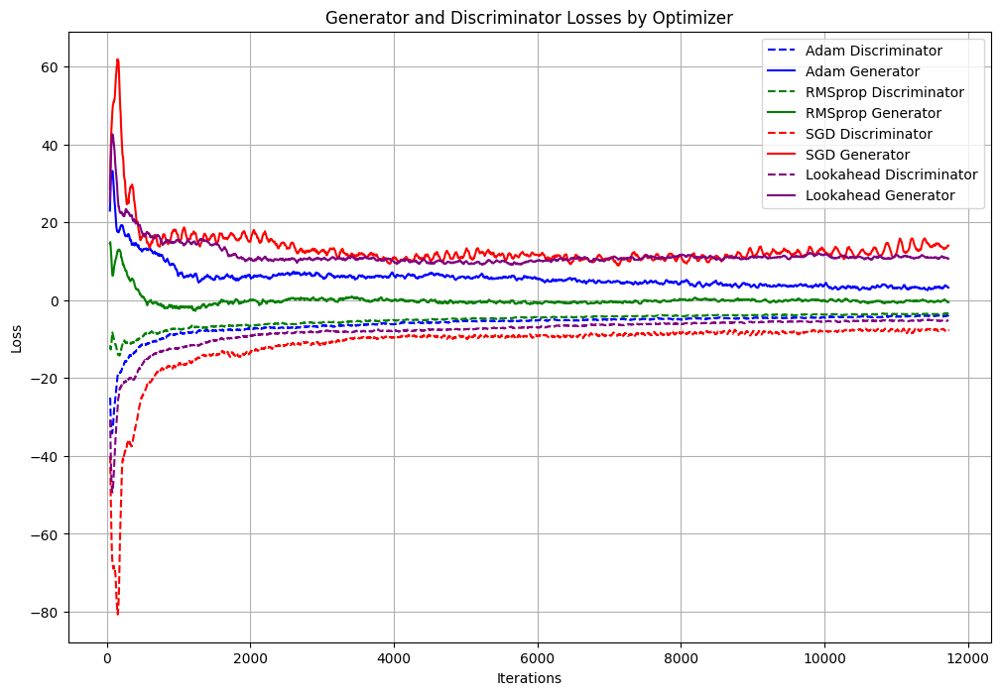

Loss plot saved to: outputs\results\all_losses_comparison.png


In [42]:
import os
from pathlib import Path
import torch
import pandas as pd
import matplotlib.pyplot as plt

def plot_losses():
    """Plot and compare loss curves for all optimizers and save the plot in the results directory."""
    plt.figure(figsize=(12, 8))

    optimizers = ['Adam', 'RMSprop', 'SGD', 'Lookahead']
    colors = ['blue', 'green', 'red', 'purple']

    for opt, color in zip(optimizers, colors):
        try:
            metrics_path = os.path.join(config.dirs['metrics'], f"{opt}_metrics.pkl")
            metrics = torch.load(metrics_path)

            # Discriminator losses (smoothed)
            d_loss = pd.Series(metrics['D_losses']).rolling(50).mean()
            plt.plot(d_loss, label=f'{opt} Discriminator', color=color, linestyle='--')

            # Generator losses (smoothed, plotted every n_critic steps)
            g_x = [i * config.n_critic for i in range(len(metrics['G_losses']))]
            g_loss = pd.Series(metrics['G_losses']).rolling(10).mean()
            plt.plot(g_x, g_loss, label=f'{opt} Generator', color=color, linestyle='-')

        except FileNotFoundError:
            print(f"Metrics not found for {opt}")

    plt.title('Generator and Discriminator Losses by Optimizer')
    plt.xlabel('Iterations')
    plt.ylabel('Loss')
    plt.legend()
    plt.grid(True)

    # Create results directory if it doesn't exist
    results_dir = config.base_dir / "results"
    results_dir.mkdir(parents=True, exist_ok=True)

    # Save plot to results directory
    plot_path = results_dir / 'all_losses_comparison.png'
    plt.savefig(plot_path)
    plt.show()
    print(f"Loss plot saved to: {plot_path}")

# Call the function
plot_losses()


# Sample Progression

Adam sample progression:


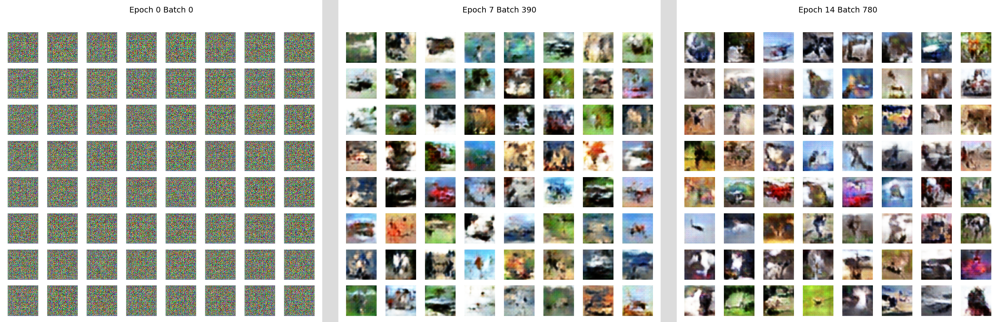

Saved: outputs\results\Adam_progression.png
RMSprop sample progression:


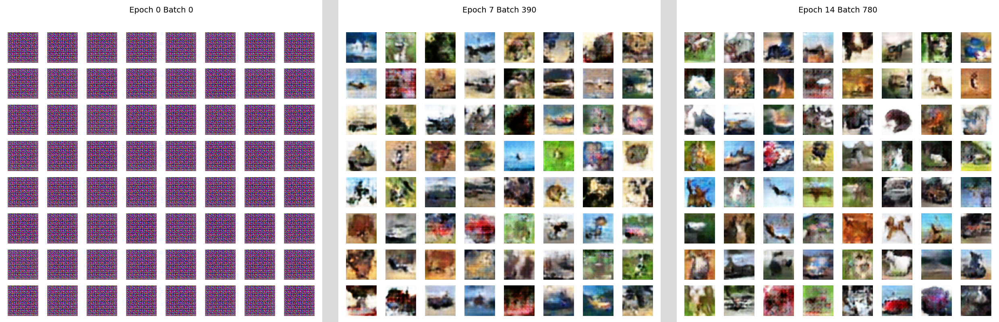

Saved: outputs\results\RMSprop_progression.png
SGD sample progression:


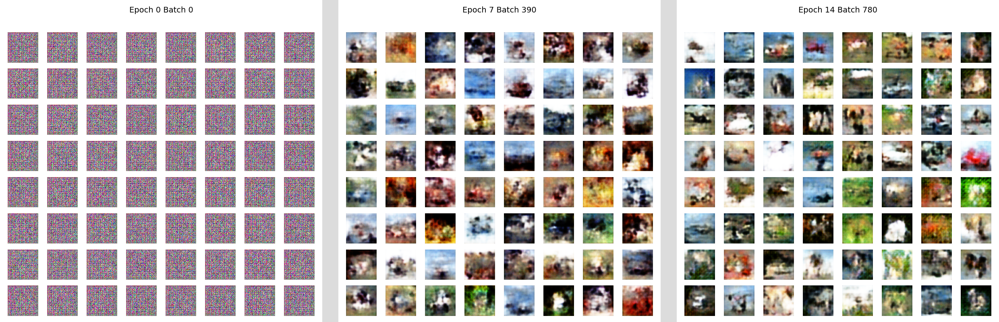

Saved: outputs\results\SGD_progression.png
Lookahead sample progression:


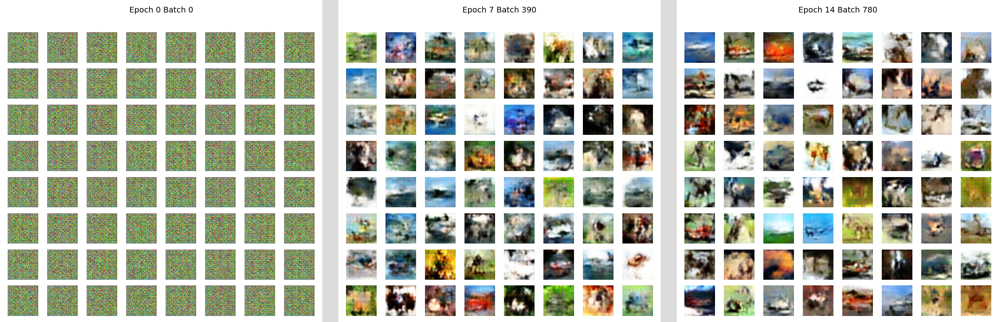

Saved: outputs\results\Lookahead_progression.png


In [35]:
import os
import re
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np
from io import BytesIO
from IPython.display import display  # Jupyter inline display


def extract_indices(filename):
    match = re.search(r'epoch(\d+)_batch(\d+)_(\d+)\.png', filename)
    if match:
        return int(match.group(1)), int(match.group(2)), int(match.group(3))
    return float('inf'), float('inf'), float('inf')

def create_image_grid(images, title=None):
    fig, axes = plt.subplots(8, 8, figsize=(8, 8))
    if title:
        fig.suptitle(title, fontsize=14)
    for ax, img in zip(axes.flatten(), images):
        ax.imshow(img)
        ax.axis('off')
    for ax in axes.flatten()[len(images):]:
        ax.axis('off')
    plt.tight_layout()
    plt.subplots_adjust(top=0.9)

    # Save to memory
    buf = BytesIO()
    plt.savefig(buf, format='png')
    plt.close(fig)
    buf.seek(0)
    return Image.open(buf)

def display_sample_progression(optimizer):
    samples_dir = os.path.join(config.dirs['samples'], optimizer)
    if not os.path.exists(samples_dir):
        print(f"No samples found for {optimizer}")
        return

    sample_files = sorted(
        [f for f in os.listdir(samples_dir) if f.endswith('.png')],
        key=extract_indices
    )

    # Group by (epoch, batch)
    batch_dict = {}
    for f in sample_files:
        match = re.search(r'epoch(\d+)_batch(\d+)_\d+\.png', f)
        if match:
            key = (int(match.group(1)), int(match.group(2)))
            batch_dict.setdefault(key, []).append(f)

    sorted_batches = sorted(batch_dict.keys())
    if len(sorted_batches) < 3:
        print(f"Not enough batches to show progression for {optimizer}")
        return

    selected_batches = [sorted_batches[0], sorted_batches[len(sorted_batches) // 2], sorted_batches[-1]]
    grid_images = []

    for batch_key in selected_batches:
        batch_files = sorted(batch_dict[batch_key], key=extract_indices)
        images = [Image.open(os.path.join(samples_dir, f)) for f in batch_files[:64]]
        title = f"Epoch {batch_key[0]} Batch {batch_key[1]}"
        grid_img = create_image_grid(images, title)
        grid_images.append(grid_img)

    # Define gap size and color
    gap_width = 40
    gap_color = (220, 220, 220)  # light gray

    widths, heights = zip(*(img.size for img in grid_images))
    total_width = sum(widths) + gap_width * (len(grid_images) - 1)
    max_height = max(heights)

    # Create final composite image with gaps
    composite = Image.new('RGB', (total_width, max_height), gap_color)
    x_offset = 0
    for i, img in enumerate(grid_images):
        composite.paste(img, (x_offset, 0))
        x_offset += img.width
        if i < len(grid_images) - 1:
            x_offset += gap_width  # Add gap only between images

    # Display inline in Jupyter
    print(f"{optimizer} sample progression:")
    display(composite)

    # Ensure results directory exists
    results_dir = config.base_dir / "results"
    results_dir.mkdir(parents=True, exist_ok=True)

    # Save the image
    output_path = results_dir / f"{optimizer}_progression.png"
    composite.save(output_path)
    print(f"Saved: {output_path}")


for optimizer in ['Adam', 'RMSprop', 'SGD', 'Lookahead']:
    display_sample_progression(optimizer)


# Final Samples

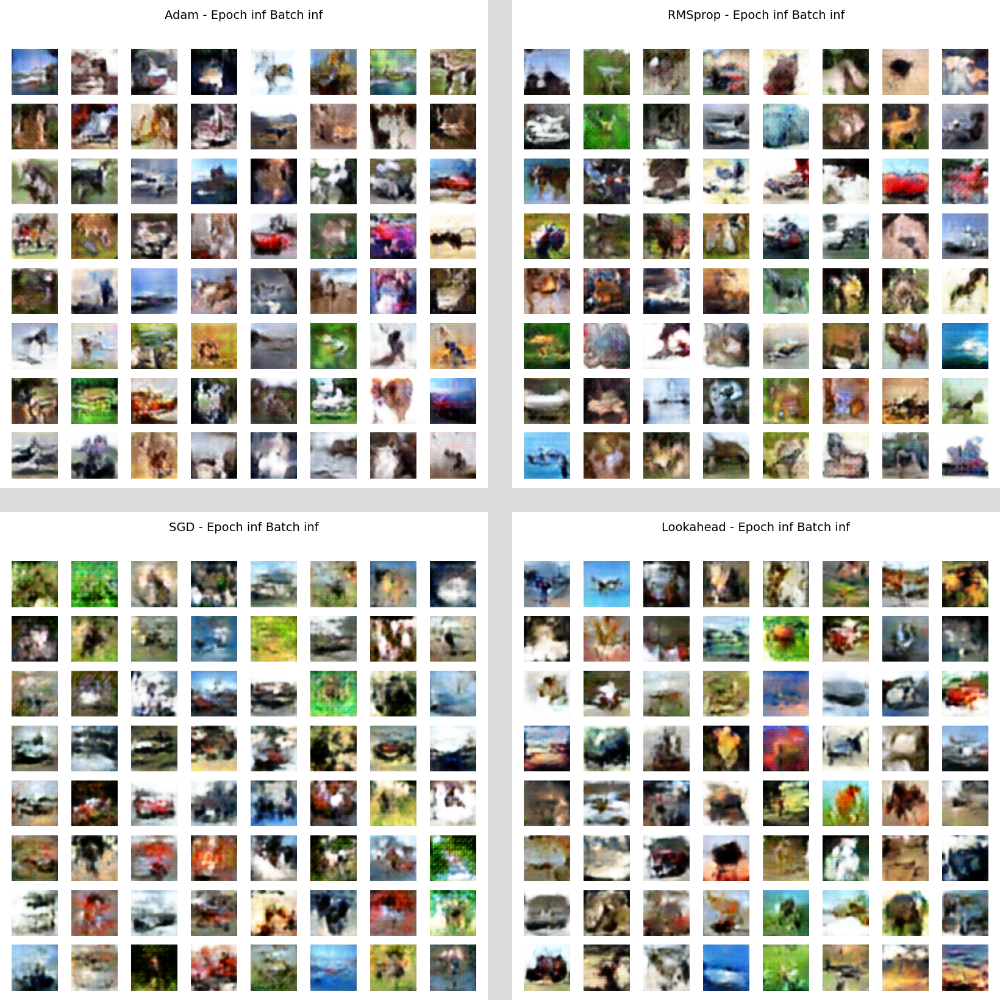

Final batch comparison saved to: outputs\results\final_samples_comparison.png


In [40]:
def compare_final_samples():
    """Compare final 64-sample grids from all optimizers in a 2x2 layout and save to results."""
    from PIL import Image
    import matplotlib.pyplot as plt

    optimizers = ['Adam', 'RMSprop', 'SGD', 'Lookahead']
    grid_images = []

    for opt in optimizers:
        samples_dir = os.path.join(config.dirs['samples'], opt)
        if not os.path.exists(samples_dir):
            print(f"No samples found for {opt}")
            continue

        sample_files = sorted(
            [f for f in os.listdir(samples_dir) if f.endswith('.png')],
            key=extract_indices
        )

        if not sample_files:
            print(f"No PNG files found for {opt}")
            continue

        # Get the latest (epoch, batch)
        last_batch_key = extract_indices(sample_files[-1])[:2]

        # Get all 64 images from the final batch
        final_batch_files = [
            f for f in sample_files if extract_indices(f)[:2] == last_batch_key
        ]
        final_batch_files = sorted(final_batch_files, key=extract_indices)[:64]

        if not final_batch_files:
            print(f"No final batch images found for {opt}")
            continue

        images = [Image.open(os.path.join(samples_dir, f)) for f in final_batch_files]
        title = f"{opt} - Epoch {last_batch_key[0]} Batch {last_batch_key[1]}"
        grid_img = create_image_grid(images, title=title)
        grid_images.append(grid_img)

    if not grid_images:
        print("No final batch images found.")
        return

    # === Create a 2x2 layout ===
    gap = 40
    gap_color = (220, 220, 220)

    # Assume all grid_images are the same size
    grid_w, grid_h = grid_images[0].size

    rows, cols = 2, 2
    total_width = cols * grid_w + (cols - 1) * gap
    total_height = rows * grid_h + (rows - 1) * gap

    composite = Image.new('RGB', (total_width, total_height), gap_color)

    for i, grid_img in enumerate(grid_images):
        row = i // cols
        col = i % cols
        x = col * (grid_w + gap)
        y = row * (grid_h + gap)
        composite.paste(grid_img, (x, y))

    # Show in notebook
    display(composite)

    # Save to results directory
    results_dir = config.base_dir / "results"
    results_dir.mkdir(parents=True, exist_ok=True)
    output_path = results_dir / "final_samples_comparison.png"
    composite.save(output_path)
    print(f"Final batch comparison saved to: {output_path}")



compare_final_samples()